In [19]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.io.wavfile import read
from scipy.fft import fft, fftfreq, fftshift
from scipy.signal import kaiserord, firwin, lfilter
from IPython.display import Audio

# Filtros adaptativos

El principio de operación de un filtro adaptativo son sus característica variables en el tiempo autoajustables. Un filtro adaptativo usualmente toma la forma de un filtro FIR, con un algoritmo de adaptación que continuamente actualiza los coeficientes del filtro, tal que la señal de error se minimiza de acuerdo a cierto criterio. La señal de error usualmente es derivada de alguna manera desde diagrama de flujo de la aplicación, tal que sea una medida de qué tan cerca el filtro está del óptimo. La mayoría de algoritmos de adaptación pueden ser llamados aproximaciones al filtro Wiener, el cuál es de vital importancia para el entendimiento de los filtros adaptativos. [1]

## 1. Least Mean Squares (LMS)

El algoritmo de los mínimos cuadrados medios es extremadamente popular por su simplicidad y facilidad de computación. El algoritmo está basado en el método de gradiente descendiente, pero es aún más simple ya que solo ejecuta una iteración por muestra, y además, calcula solo un estimado del vector gradiente por cada muestra.
<p style="text-align: center;"> $w_{k+1}(i) = w_k (i) + 2 \mu e_k x_{k-i}$, para $i$ desde $0$ hasta $N - 1$ </p>
El parámetro $\mu$ es una constante que regula la estabilidad y rapidez de convergencia, para calcular el valor del error se usa:
<p style="text-align: center;"> $e_k = y_k - \sum\limits_{i=0}^{N-1} w(i) \cdot x_{k-i}$ </p>

### 1.1. Cargue el archivo `voices.wav` que contiene una pista de voces, grafique la señal y reproduzca el audio.

/tmp/ipykernel_90659/198505310.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, voices = read("voices.wav")


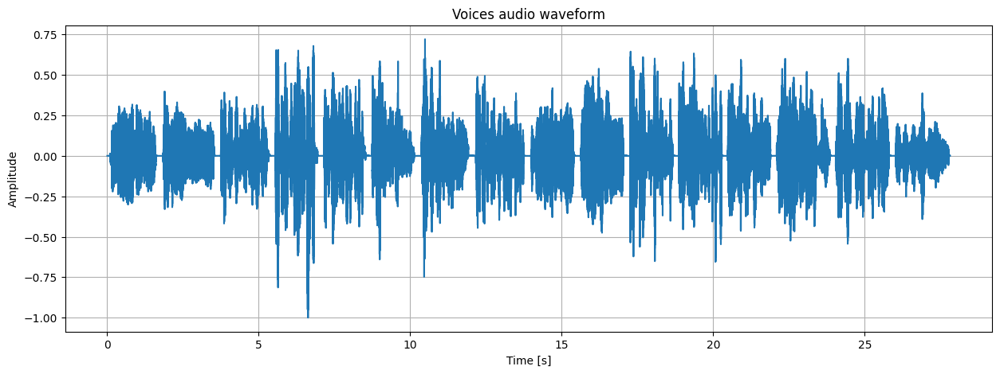

In [2]:
# Cargar el audio
fs, voices = read("voices.wav")

# Normalizar el audio
normalize = lambda x: x / float(max(abs(x)))

voices = normalize(voices)

t1 = np.arange(0, float(len(voices))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5))
plt.plot(t1, voices)
plt.title("Voices audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(voices, rate=fs)

### 1.2. Cargue el archivo `rock.wav` que contiene una pista musical, grafique la señal y reproduzca el audio.

/tmp/ipykernel_90659/238684465.py:2: WavFileWarning: Chunk (non-data) not understood, skipping it.
  fs, rock = read("rock.wav");


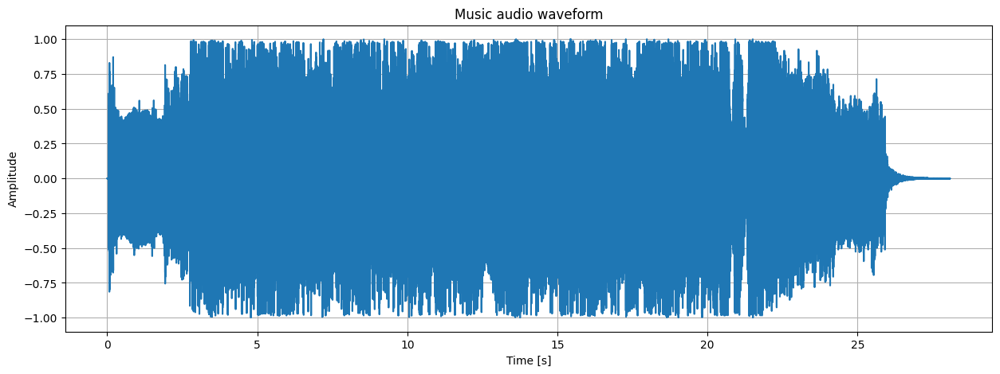

In [3]:
# Cargar el audio
fs, rock = read("rock.wav");

rock = normalize(rock)

t2 = np.arange(0, float(len(rock))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5))
plt.plot(t2, rock)
plt.title("Music audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()
plt.show()

# Reproducir audio
Audio(rock, rate=fs)

### 1.3. Ahora combine los dos audios, asegurándose de que los dos audios terminen al mismo tiempo sin alterar la longitud del audio más largo, reproduzca el resultado.

In [4]:
L = max(len(voices), len(rock))
rock = np.pad(rock, [0, L - len(rock)])
voices = np.pad(voices, [L - len(voices), 0])
combined = voices + rock

Audio(combined, rate=fs)

### 1.4. Grafique el espectro de los audios por separado ¿Qué filtro utilizaría para intentar separar la voz del audio?

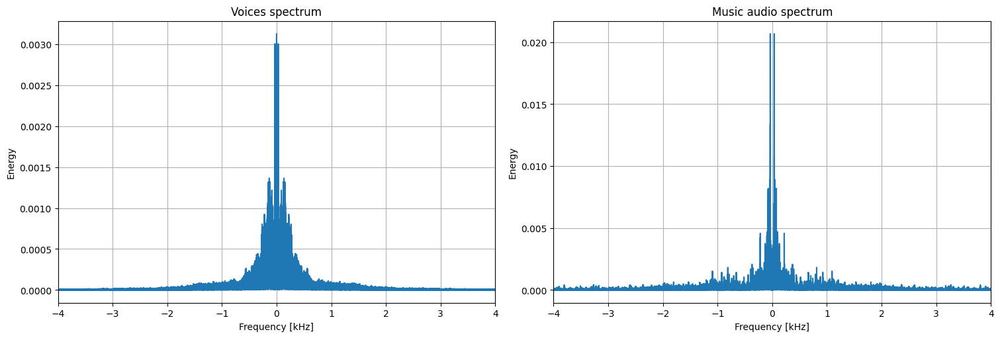

In [5]:
def spectrum(x, fs):
    N = int(2**np.ceil(np.log2(len(voices))))
    X = fftshift(fft(x, N, norm="forward"))
    f = fftshift(fftfreq(len(X)))*fs/2
    return f, X

freqs_voices, fft_voices = spectrum(voices, fs)
freqs_rock, fft_rock = spectrum(rock, fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")

plt.subplot(1, 2, 1)
plt.plot(freqs_voices/1e3, np.abs(fft_voices))
plt.title("Voices spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_rock/1e3, np.abs(fft_rock))
plt.title("Music audio spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.grid()

plt.show()

Es difícil sugerir un filtro y una frecuencia de corte que permitiera extraer solamente las voces del audio, sin embargo un posible filtro sería un pasabajas con frecuencia de corte en 800 Hz.

### 1.4. Según su respuesta al numeral anterior implemente un filtro FIR con esas características, grafique la forma de onda y el espectro del resultado del filtro y reproduzca el audio filtrado ¿Fue posible remover la música usando este filtro? Puede utilizar una de las siguientes funciones.

In [6]:
def low_pass_filter(fs, cutoff_hz, roll_off, ripple_dB):
    nyq_rate = fs / 2.0
    width = roll_off/nyq_rate
    N, _ = kaiserord(ripple_dB, width)
    taps = firwin(N, cutoff_hz/nyq_rate, pass_zero="lowpass")
    return taps

def high_pass_filter(fs, cutoff_hz, roll_off, ripple_dB):
    nyq_rate = fs / 2.0
    width = roll_off/nyq_rate
    N, _ = kaiserord(ripple_dB, width)
    taps = firwin(N, cutoff_hz/nyq_rate, pass_zero="highpass")
    return taps

In [7]:
fc = 800

roll_off = 200
ripple_dB = 60

taps = low_pass_filter(fs, fc, roll_off, ripple_dB)

In [8]:
fir_filtered = lfilter(taps, 1.0, combined)

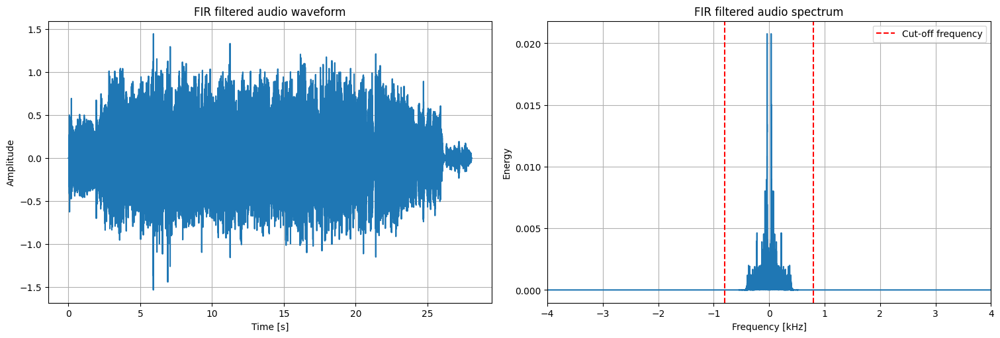

In [9]:
freqs_fir, fft_fir = spectrum(fir_filtered, fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")

plt.subplot(1, 2, 1)
plt.plot(t2, fir_filtered)
plt.title("FIR filtered audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_fir/1e3, np.abs(fft_fir))
plt.axvline(800/1e3, linestyle="dashed", color="red", label="Cut-off frequency")
plt.axvline(-800/1e3, linestyle="dashed", color="red")
plt.title("FIR filtered audio spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.legend(loc="upper right")
plt.grid()

In [10]:
Audio(fir_filtered, rate = fs)

No, el filtro solamente pudo atenuar ligeramente el volumen de la música, pero no pudo deshacerse de ella completamente.

### 1.5. Utilice un filtro LMS para filtrar la señal combinada, como parámetro `x` use la señal combinada, como parámetro `d` use la señal de voz individual, y como parámetro `mu` use 0.1, grafique la forma de onda y el resultado en el dominio de la frecuencia, reproduzca el resultado ¿Fue posible aislar las voces? ¿Por qué algunas resultaron distorsionadas y otras no? Puede ayudarse de la siguiente función para implementar el filtro LMS.

In [11]:
def lms(x, d, N = 4, mu = 0.1):
    nIters = min(len(x), len(d)) - N
    # Copia de la señal
    u = np.zeros(N)
    # Coeficientes del filtro
    w = np.zeros(N)
    # Salida del filtro
    n = np.zeros(nIters)
    # Error estimado
    e = np.zeros(nIters)
    for k in range(nIters):
        # Tomar una copia de la señal
        u[1:] = u[:-1]
        u[0] = x[k]
        # Calcular la salida del filtro
        n[k] = np.dot(u, w)
        # Calcular el error estimado
        e_k = d[k] - n[k]
        # Actualizar los pesos del filtro
        w = w + 2*mu * e_k * u
        e[k] = e_k
    return n

In [12]:
lms_filtered = lms(combined, voices, mu=0.1)

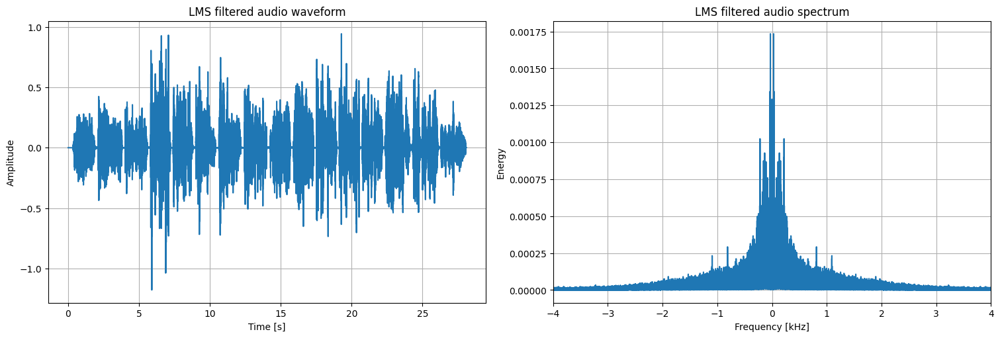

In [13]:
freqs_lms, fft_lms = spectrum(lms_filtered, fs)
t3 = np.arange(0, float(len(lms_filtered))/fs, 1.0/fs)

# Graficar
plt.figure(figsize=(15, 5), layout="constrained")

plt.subplot(1, 2, 1)
plt.plot(t3, lms_filtered)
plt.title("LMS filtered audio waveform")
plt.xlabel("Time [s]")
plt.ylabel("Amplitude")
plt.grid()

plt.subplot(1, 2, 2)
plt.plot(freqs_lms/1e3, np.abs(fft_lms))
plt.title("LMS filtered audio spectrum")
plt.xlabel("Frequency [kHz]")
plt.ylabel("Energy")
plt.xlim(-4, 4)
plt.grid()

In [14]:
Audio(lms_filtered, rate=fs)

Sí, fue posible aislar las voces del audio, sin embargo estas quedaron afectadas por ruido en donde la música se superponía con ellas, por esta misma razón la última voz fue extraída con éxito ya que no tenía pista musical superpuesta.

### 1.6. Aplique el filtro para los valores de $\mu$ de 0.001, 0.01, 0.1 y 0.2. Concluya.

In [15]:
mu = 0.001
lms_filtered1 = lms(combined, voices, mu=mu)
Audio(lms_filtered1, rate=fs)

In [16]:
mu = 0.01
lms_filtered2 = lms(combined, voices, mu=mu)
Audio(lms_filtered2, rate=fs)

In [17]:
mu = 0.1
lms_filtered3 = lms(combined, voices, mu=mu)
Audio(lms_filtered2, rate=fs)

In [18]:
mu = 0.2
lms_filtered4 = lms(combined, voices, mu=mu)
Audio(lms_filtered4, rate=fs)

En los valores de $\mu$ bajos el filtro no alcanza a atenuar la señal indeseada completamente, esto porque el valor tan bajo de $\mu$ no le permite una rápida convergencia en un mínimo del error, para el valor de 0.1, se observa que la música es casi imperceptible, aunque la señal fue desafortunadamente distorsionada, para el valor de 0.2 el filtro tiene una retroalimentación tan alta que la señal se ve completamente atenuada.

## Conclusiones

- Los filtros adaptativos son filtros capaces de calcular automáticamente sus coeficientes, lo que permite una rápida implementación y versatilidad de uso.
- El algoritmo LMS es un algoritmo bastante sencillo que permite un filtro adaptativo lineal en el dominio del tiempo.
- Los filtros adaptativos además permiten filtrar sin tener que realizar un análisis temporal o en el dominio de la frecuencia.